In [20]:
from celebrity_recognition_ai.ml import models

from celebrity_recognition_ai.ml.mobilenet_v2_100 import Mobilenet_100

from celebrity_recognition_ai.ml.student_bo import StudentNetbo
from celebrity_recognition_ai.ml import etudiant
from celebrity_recognition_ai.ml import etudiant2

from celebrity_recognition_ai.ml.ModifiedCelebrityRegressor import ModifiedCelebrityRegressor
from celebrity_recognition_ai.ml.ModifiedStudentb0Regressor import ModifiedStudentNetboRegressor
from celebrity_recognition_ai.ml.ModifiedEtudiantReg import ModifiedStudentRegEfficientNetB4
from celebrity_recognition_ai.ml.modifiedStudentCosinus import ModifiedStudentNetboCosinu
from celebrity_recognition_ai.ml.modifiedMobileRegressor import modifiedMobilenet_100Reg

from celebrity_recognition_ai.ml.data import get_train_and_validation_images_path
from celebrity_recognition_ai.ml.data import CelebrityDataset

from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import time
import numpy as np
import yaml


In [21]:
import torch
print(torch.cuda.is_available())
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


True


In [22]:
# Vider les caches CUDA
torch.cuda.empty_cache()

In [23]:
file_path ="/home/holy/Documents/memoire/celebrity-recognition-ai/celebrity_recognition_ai/configs/celebrity-config.yaml"
with open(file_path,"r") as file :
    content = yaml.safe_load(file)
    categories = content["transverse"]["categories"]

In [24]:
base_path = "../celebrity-recognition-ai/Data2"
(trainset, valset) = get_train_and_validation_images_path(base_path,categories,percentage_train=0.0)


In [25]:
len(trainset)

0

In [26]:
len(valset)

1200

In [27]:
trainsetloader = CelebrityDataset(trainset, categories,train= True)
valsetloader = CelebrityDataset(valset,categories,train=False)
len_trainset = len(trainsetloader)
len_valset = len(valsetloader)
len_trainset,len_valset

(0, 1094)

In [28]:
valsetloader

In [29]:
#     # Dataloaders
# train_loader = torch.utils.data.DataLoader(
#         trainsetloader, batch_size= 16, shuffle=True, num_workers=8
#     )

val_loader = torch.utils.data.DataLoader(
        valsetloader, batch_size= 24, shuffle=True, num_workers=8
    )

# Evaluation des  modèles

##### Fonction d'evalution

In [30]:

def evaluate_model(model, data_loader, device,modified = False):
    model.eval()
    all_preds = []
    all_targets = []
    correct = 0
    total_sample = 0
    total_latency = 0  # Variable pour mesurer le temps de latence total

    with torch.no_grad():
        for data, target in data_loader:
            data, target = data.to(device), target.to(device)

            # Démarrer le chronomètre avant la prédiction
            start_time = time.time()

            if modified ==True:
                 outputs,_ = model(data)
            else:
                outputs = model(data)

           
            _, preds = torch.max(outputs, 1)
            end_time = time.time()
            # Arrêt  du chronomètre et calcule de la latence pour ce lot
            batch_latency = end_time - start_time
            total_latency += batch_latency

            # Convertir les cibles one-hot en indices de classes
            target = torch.argmax(target, dim=1)

            correct += (target == preds).sum().item()
            total_sample += len(target)
            all_preds.append(preds.cpu().numpy())
            all_targets.append(target.cpu().numpy())
            
    all_preds = np.concatenate(all_preds)
    all_targets = np.concatenate(all_targets)
    average_accuracy = 100 * correct / total_sample

    # Calcule du rapport de classification
    report = classification_report(all_targets, all_preds, target_names=data_loader.dataset.categories, output_dict=True)
    print(f'Rapport de classification:\n{classification_report(all_targets, all_preds, target_names=data_loader.dataset.categories)}')

    # Matrice de confusion
    cm = confusion_matrix(all_targets, all_preds)

    # Affichage de la matrice de confusion avec Seaborn
    plt.figure(figsize=(10, 7))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=data_loader.dataset.categories, yticklabels=data_loader.dataset.categories)
    plt.xlabel('Prédictions')
    plt.ylabel('Réelles')
    plt.title('Matrice de Confusion')
    plt.xticks(rotation=45)  
    plt.yticks(rotation=0)
    plt.show()

    # Calcule de l'accuracy globale
    accuracy = report['accuracy']
    accuracy_manuel = average_accuracy
    print(f'Accuracy: {accuracy*100:.2f}%')
    print(f'Accuracy_manuel: {accuracy_manuel:.2f}%')

    # Temps de latence moyen par échantillon
    avg_latency = total_latency / total_sample
    print(f'Latence moyenne par échantillon: {avg_latency:.6f} secondes')

    return all_preds, all_targets, accuracy, accuracy_manuel, avg_latency



In [31]:
categorie = ['alassane-dramane-ouattara',
 'arafat-dj',
 'didi-b',
 'didier-drogba',
 'henri-konan-bedie',
 'laurent-gbagbo']

/tmp/ipykernel_5460/839163969.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_cel.load_state_dict(torch.load(model_path_1))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.82      0.89      0.85       186
                arafat-dj       0.91      0.95      0.93       187
                   didi-b       0.88      0.89      0.89       165
            didier-drogba       0.95      0.92      0.94       188
        henri-konan-bedie       0.88      0.91      0.89       185
           laurent-gbagbo       0.91      0.78      0.84       183

                 accuracy                           0.89      1094
                macro avg       0.89      0.89      0.89      1094
             weighted avg       0.89      0.89      0.89      1094



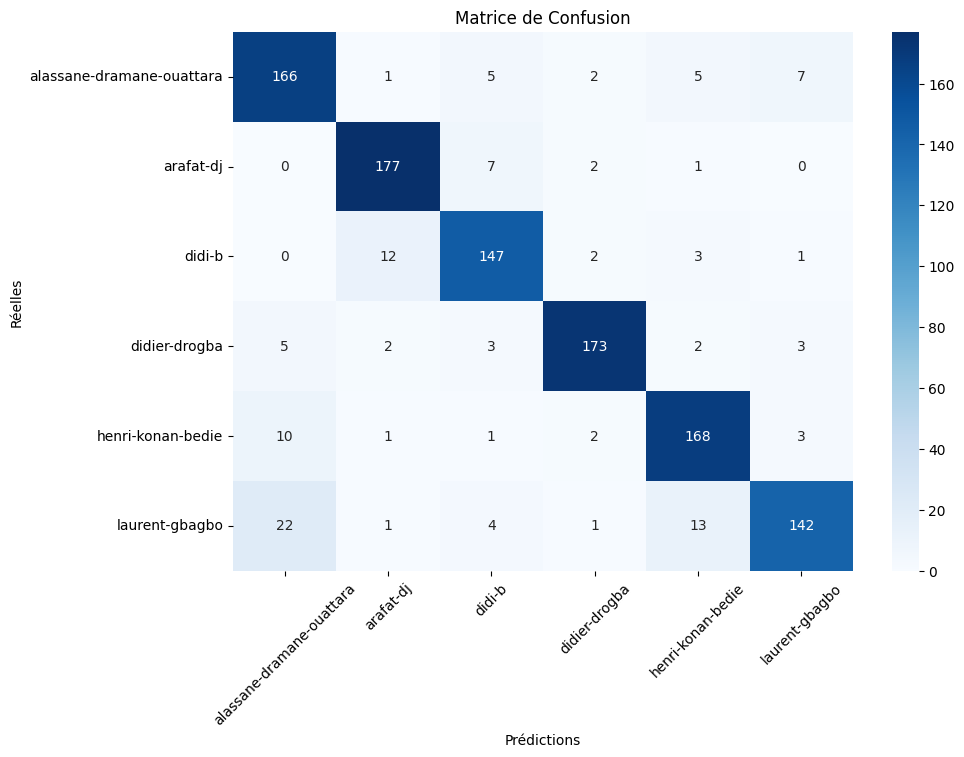

Accuracy: 88.94%
Accuracy_manuel: 88.94%
Latence moyenne par échantillon: 0.001288 secondes


In [32]:
# Chargement du modèle Enseignant et recuperation de l'accuracy et du temps de latence
net_cel = models.CelebrityNet()  
model_path_1 ='celebrity_recognition_ai/app/trained-models/celebritynet.pth'
net_cel.load_state_dict(torch.load(model_path_1))
net_cel =net_cel.to(device)
_,_,train_accuracy_celebrityNet,_,train_latence_celebrity=evaluate_model(net_cel, val_loader, device)

/tmp/ipykernel_5460/2529310820.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_stud.load_state_dict(torch.load(model_path_2))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.72      0.74      0.73       186
                arafat-dj       0.83      0.73      0.78       187
                   didi-b       0.80      0.52      0.63       165
            didier-drogba       0.88      0.71      0.79       188
        henri-konan-bedie       0.93      0.62      0.74       185
           laurent-gbagbo       0.47      0.92      0.63       183

                 accuracy                           0.71      1094
                macro avg       0.77      0.71      0.72      1094
             weighted avg       0.77      0.71      0.72      1094



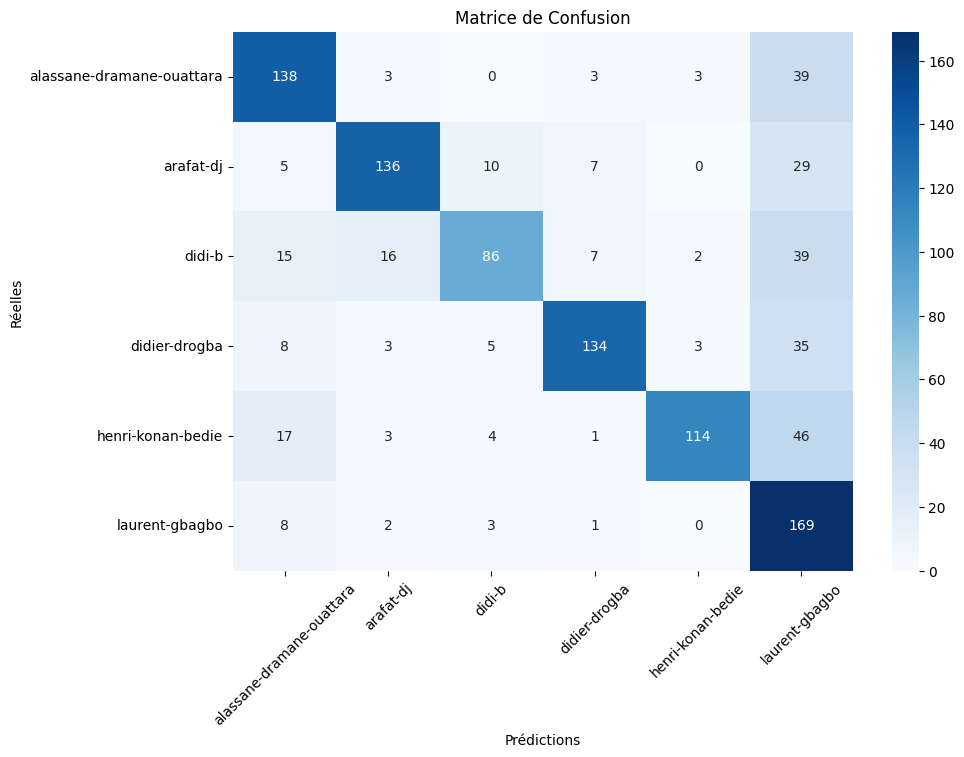

Accuracy: 71.02%
Accuracy_manuel: 71.02%
Latence moyenne par échantillon: 0.000321 secondes


In [33]:
# Chargement du modèle entrainé avec du module etudiant

net_stud = etudiant.StudentEfficientNetB4()
model_path_2 ='etudiant_0.pth'
net_stud.load_state_dict(torch.load(model_path_2))
net_stud=net_stud.to(device)
_,_,train_accuracy_StudentEfficientNet,_,train_latence__StudentEfficientNet=evaluate_model(net_stud, val_loader, device)

/tmp/ipykernel_5460/2407700362.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_mobil.load_state_dict(torch.load(model_path_3))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.89      0.97      0.93       186
                arafat-dj       0.96      0.98      0.97       187
                   didi-b       0.93      0.93      0.93       165
            didier-drogba       0.96      0.95      0.96       188
        henri-konan-bedie       0.98      0.95      0.96       185
           laurent-gbagbo       0.99      0.92      0.95       183

                 accuracy                           0.95      1094
                macro avg       0.95      0.95      0.95      1094
             weighted avg       0.95      0.95      0.95      1094



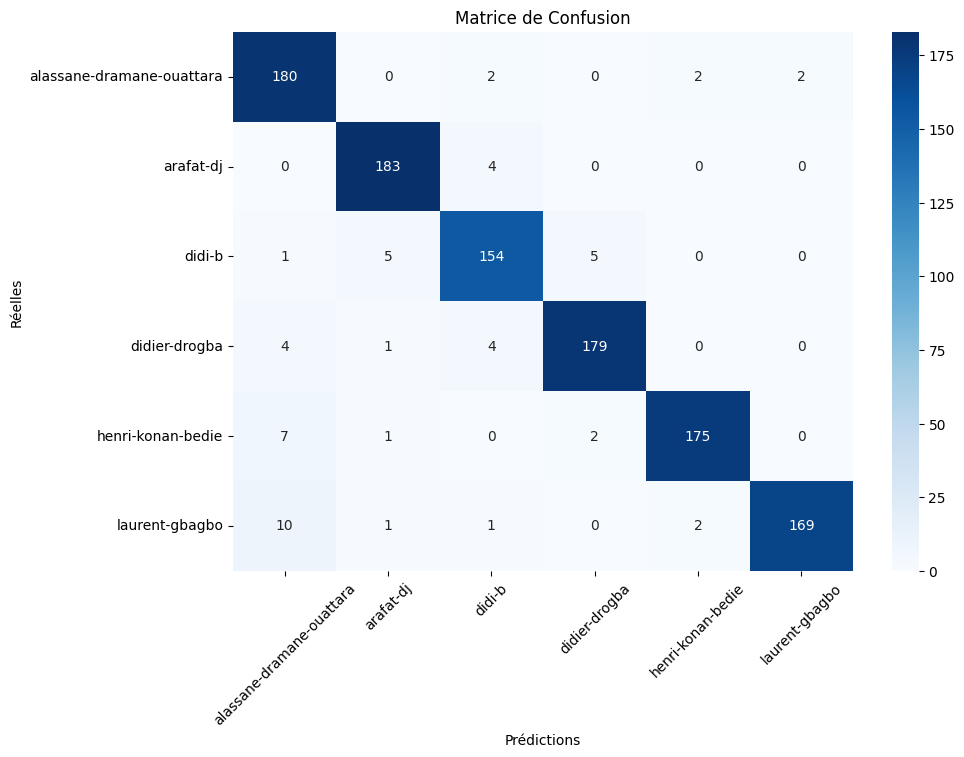

Accuracy: 95.06%
Accuracy_manuel: 95.06%
Latence moyenne par échantillon: 0.000460 secondes


In [34]:
# Chargement du modèle entrainé avec Mobilenet_100 du module mobilenet_v2_100
net_mobil = Mobilenet_100()
model_path_3 ='stu_mobileNet.pth'
net_mobil.load_state_dict(torch.load(model_path_3))
net_mobil=net_mobil.to(device)
_,_,train_accuracy_Mobilenet_100,_,train_latence__Mobilenet_100 =evaluate_model(net_mobil, val_loader, device)

/tmp/ipykernel_5460/1927683222.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_bo.load_state_dict(torch.load(model_path_4))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.95      0.97      0.96       186
                arafat-dj       0.98      0.99      0.99       187
                   didi-b       0.96      0.96      0.96       165
            didier-drogba       0.99      0.97      0.98       188
        henri-konan-bedie       0.96      0.98      0.97       185
           laurent-gbagbo       0.99      0.95      0.97       183

                 accuracy                           0.97      1094
                macro avg       0.97      0.97      0.97      1094
             weighted avg       0.97      0.97      0.97      1094



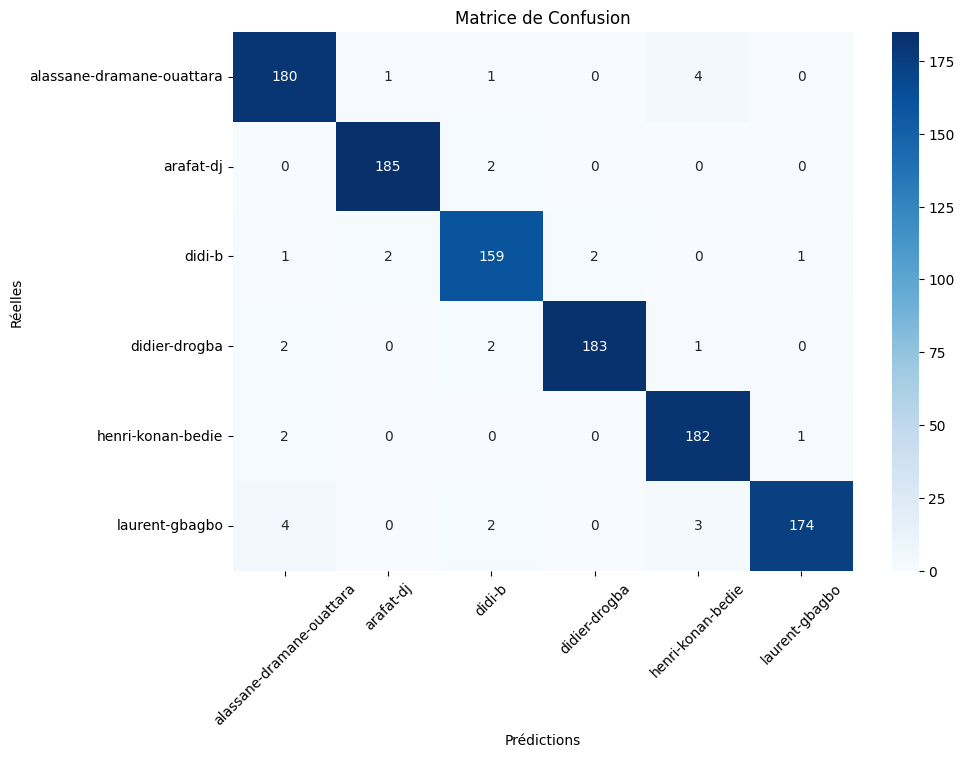

Accuracy: 97.17%
Accuracy_manuel: 97.17%
Latence moyenne par échantillon: 0.000708 secondes


In [35]:
# Chargement du modèle entrainé avec du module student_bo.py

net_bo = StudentNetbo()
model_path_4 ='etudi_bo_reg0123.pth'

net_bo.load_state_dict(torch.load(model_path_4))
net_bo=net_bo.to(device)
_,_,train_accuracy_StudentNetbo,_,train_latence__StudentNetbo=evaluate_model(net_bo, val_loader, device)

/tmp/ipykernel_5460/2577164502.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_mobilReg.load_state_dict(torch.load(model_path_7))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.96      0.98      0.97       186
                arafat-dj       0.98      0.97      0.98       187
                   didi-b       0.95      0.95      0.95       165
            didier-drogba       0.99      0.98      0.99       188
        henri-konan-bedie       0.99      0.96      0.98       185
           laurent-gbagbo       0.96      0.99      0.97       183

                 accuracy                           0.97      1094
                macro avg       0.97      0.97      0.97      1094
             weighted avg       0.97      0.97      0.97      1094



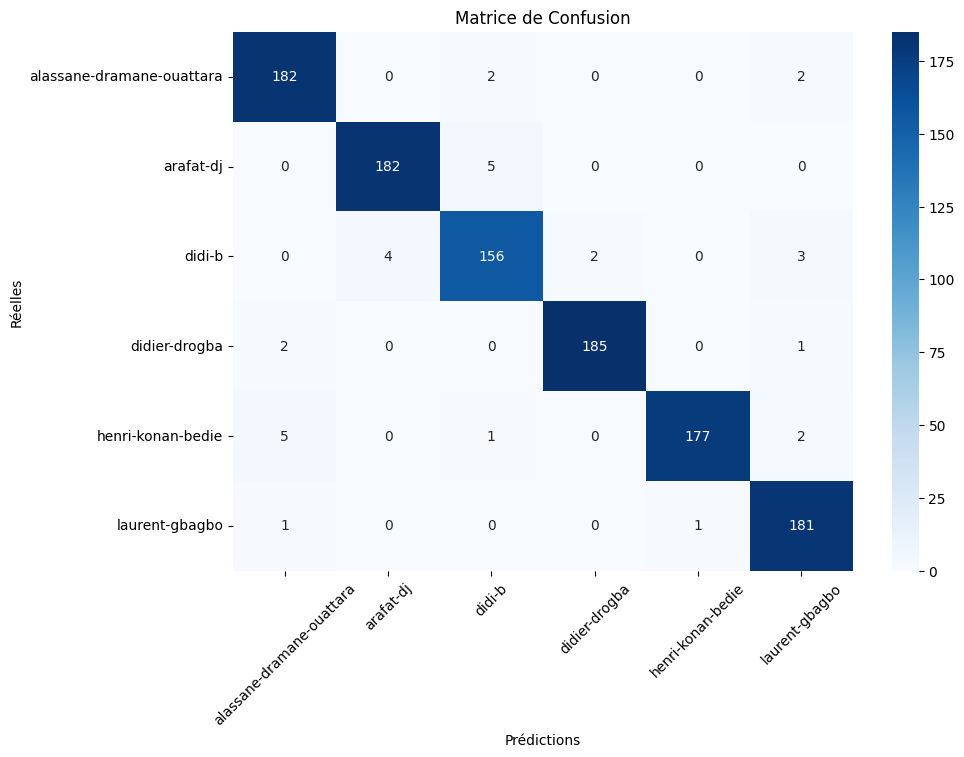

Accuracy: 97.17%
Accuracy_manuel: 97.17%
Latence moyenne par échantillon: 0.000793 secondes


In [36]:
# Chargement du modèle entrainé avec Mobilenet_100 du module mobilenet_v2_100
net_mobilReg=  modifiedMobilenet_100Reg()
model_path_7 ='mobil_reg001.pth'
net_mobilReg.load_state_dict(torch.load(model_path_7))
net_mobilReg=net_mobilReg.to(device)
_,_,train_accuracy_modifiedMobilenet_100Reg,_,train_latence__modifiedMobilenet_100Reg =evaluate_model(net_mobilReg, val_loader, device,True)

/tmp/ipykernel_5460/2233780969.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_reg.load_state_dict(torch.load(model_path_5))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.99      0.99      0.99       186
                arafat-dj       0.97      0.98      0.98       187
                   didi-b       0.96      0.96      0.96       165
            didier-drogba       0.99      0.99      0.99       188
        henri-konan-bedie       0.97      0.98      0.98       185
           laurent-gbagbo       0.99      0.96      0.98       183

                 accuracy                           0.98      1094
                macro avg       0.98      0.98      0.98      1094
             weighted avg       0.98      0.98      0.98      1094



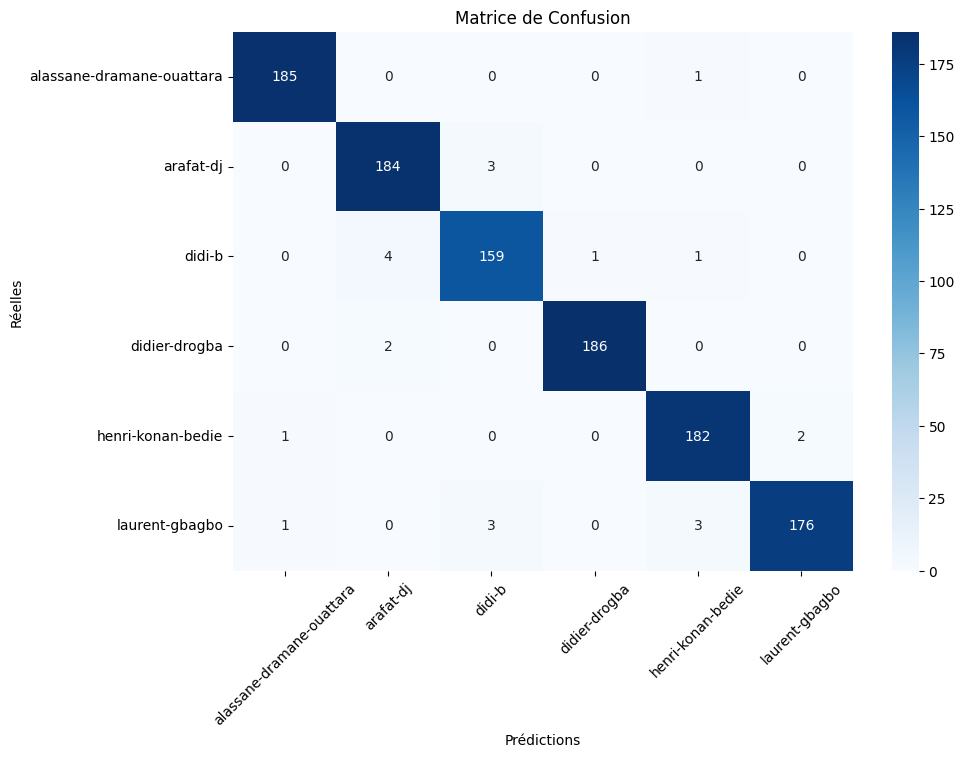

Accuracy: 97.99%
Accuracy_manuel: 97.99%
Latence moyenne par échantillon: 0.000785 secondes


In [37]:
# Modèle  with regressor
model_path_5 ='student_regressor0.pth'

net_reg = ModifiedStudentNetboRegressor()
net_reg.load_state_dict(torch.load(model_path_5))
net_reg.to(device)
_,_,train_accuracy_ModifiedStudentNetboRegressor,_,train_latence__ModifiedStudentNetboRegressor=evaluate_model(net_reg, val_loader, device,True)

/tmp/ipykernel_5460/4005441063.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_cos.load_state_dict(torch.load(path_6))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.97      0.98      0.97       186
                arafat-dj       0.97      0.98      0.98       187
                   didi-b       0.98      0.96      0.97       165
            didier-drogba       0.99      0.96      0.98       188
        henri-konan-bedie       0.96      0.99      0.97       185
           laurent-gbagbo       0.98      0.98      0.98       183

                 accuracy                           0.97      1094
                macro avg       0.97      0.97      0.97      1094
             weighted avg       0.97      0.97      0.97      1094



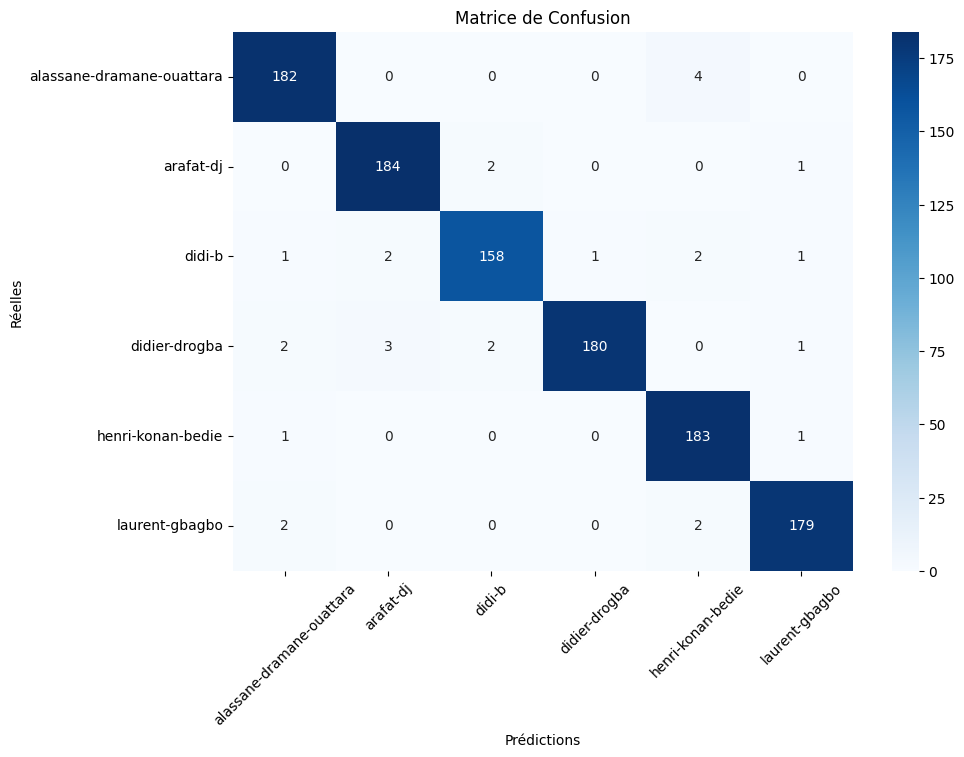

Accuracy: 97.44%
Accuracy_manuel: 97.44%
Latence moyenne par échantillon: 0.000736 secondes


In [38]:
# Modèle modified Cosinus loss
path_6 ="student_bo_cosLoss_0.pth"
net_cos = ModifiedStudentNetboCosinu()
net_cos.load_state_dict(torch.load(path_6))
net_cos.to(device)
_,_,train_accuracy_ModifiedStudentNetboCosinu,_,train_latence__ModifiedStudentNetboCosinu=evaluate_model(net_cos, val_loader, device,True)

#### Comparaison des modèles

In [39]:
# Nombre de paramètre de chaque modèle
params_celebrity = "{:,}".format(sum(p.numel() for p in net_cel.parameters()))
print(f"Celebrity parameters: {params_celebrity }")
params_studentNetb4= "{:,}".format(sum(p.numel() for p in net_stud.parameters()))
print(f"studentNetb4: {params_studentNetb4}")
params_mobileNet = "{:,}".format(sum(p.numel() for p in net_mobil.parameters()))
print(f"mobilenet parameters: {params_mobileNet }")
params_studentbo= "{:,}".format(sum(p.numel() for p in net_bo.parameters()))
print(f"stubo parameters: {params_studentbo}")
params_studentboReg= "{:,}".format(sum(p.numel() for p in net_reg.parameters()))
print(f"studBoReg parameters: {params_studentboReg}")
params_studentboCosinus= "{:,}".format(sum(p.numel() for p in net_cos.parameters()))
print(f"Stu paramboCos parameters: {params_studentboCosinus}")
params_mobileReg= "{:,}".format(sum(p.numel() for p in net_mobilReg.parameters()))
print(f"mobilenetReg parameters: {params_mobileReg}")


Celebrity parameters: 17,559,374
studentNetb4: 6,827,430
mobilenet parameters: 2,231,558
stubo parameters: 4,015,234
studBoReg parameters: 9,981,250
Stu paramboCos parameters: 6,310,786
mobilenetReg parameters: 6,892,900


In [40]:
import os

In [41]:
from tabulate import tabulate

# Données pour le tableau
data = [
    ["CelebrityNet", train_accuracy_celebrityNet, train_latence_celebrity,os.path.getsize(model_path_1)/1024,params_celebrity
],
    ["StudentEfficientNet", train_accuracy_StudentEfficientNet, train_latence__StudentEfficientNet,os.path.getsize(model_path_2)/1024,params_studentNetb4],
    ["Mobilenet_100",train_accuracy_Mobilenet_100,train_latence__Mobilenet_100,os.path.getsize(model_path_3)/1024,params_mobileNet],
    ["StudentNetbo",train_accuracy_StudentNetbo,train_latence__StudentNetbo,os.path.getsize(model_path_4)/1024,params_studentbo],
    ["ModifiedStudentNetboRegressor", train_accuracy_ModifiedStudentNetboRegressor,train_latence__ModifiedStudentNetboRegressor,os.path.getsize(model_path_5)/1024,params_studentboReg],
    ["ModifiedStudentNetboCosinu", train_accuracy_ModifiedStudentNetboCosinu,train_latence__ModifiedStudentNetboCosinu,os.path.getsize(path_6)/1024,params_studentboCosinus],
    ["ModifiedMobileReg", train_accuracy_modifiedMobilenet_100Reg,train_latence__modifiedMobilenet_100Reg,os.path.getsize(model_path_7)/1024,params_mobileReg],






]

# En-têtes du tableau
headers = ["Models", "Train Accuracy", "Train Latency","Taille", "model parameter"]

# Affichage du tableau
print("                                       BENCHMARK TRAIN")

print(tabulate(data, headers=headers, tablefmt="pretty"))


                                       BENCHMARK TRAIN
+-------------------------------+--------------------+-----------------------+-----------------+-----------------+
|            Models             |   Train Accuracy   |     Train Latency     |     Taille      | model parameter |
+-------------------------------+--------------------+-----------------------+-----------------+-----------------+
|         CelebrityNet          | 0.8893967093235832 | 0.0012876889387475944 | 69326.13671875  |   17,559,374    |
|      StudentEfficientNet      | 0.7102376599634369 | 0.0003211075470695984 | 26840.271484375 |    6,827,430    |
|         Mobilenet_100         | 0.9506398537477148 | 0.0004603721106074192 |  8961.93359375  |    2,231,558    |
|         StudentNetbo          | 0.9716636197440585 | 0.0007075546428533969 | 15979.416015625 |    4,015,234    |
| ModifiedStudentNetboRegressor | 0.979890310786106  | 0.0007851245852231543 | 39287.353515625 |    9,981,250    |
|  ModifiedStudentNetboCo

##### visualisation

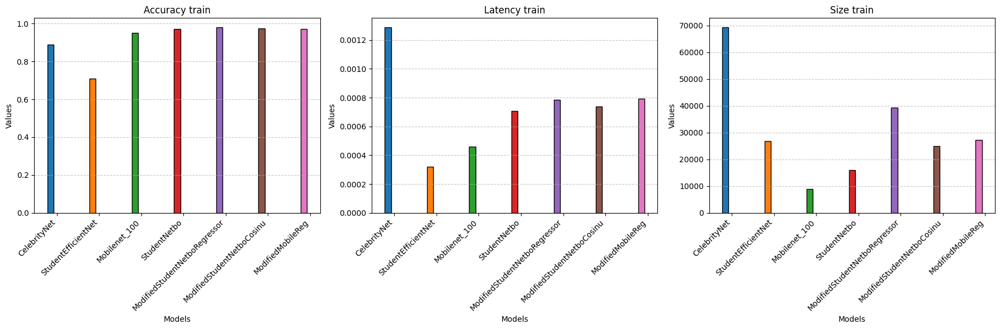

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

# Données pour chaque modèle
modeles = ["CelebrityNet", "StudentEfficientNet", "Mobilenet_100", "StudentNetbo", "ModifiedStudentNetboRegressor", "ModifiedStudentNetboCosinu","ModifiedMobileReg"]
accuracies = [
    train_accuracy_celebrityNet,
    train_accuracy_StudentEfficientNet,
    train_accuracy_Mobilenet_100,
    train_accuracy_StudentNetbo,
    train_accuracy_ModifiedStudentNetboRegressor,
    train_accuracy_ModifiedStudentNetboCosinu,
    train_accuracy_modifiedMobilenet_100Reg
    
]
latencies = [
    train_latence_celebrity,
    train_latence__StudentEfficientNet,
    train_latence__Mobilenet_100,
    train_latence__StudentNetbo,
    train_latence__ModifiedStudentNetboRegressor,
    train_latence__ModifiedStudentNetboCosinu,
    train_latence__modifiedMobilenet_100Reg
]
sizes = [
    os.path.getsize(model_path_1) / 1024,
    os.path.getsize(model_path_2) / 1024,
    os.path.getsize(model_path_3) / 1024,
    os.path.getsize(model_path_4) / 1024,
    os.path.getsize(model_path_5) / 1024,
    os.path.getsize(path_6) / 1024,
    os.path.getsize(model_path_7) / 1024
]

# Créer la figure et les sous-graphes
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6), sharey=False)

# Palette de couleurs pour les modèles
colors = sns.color_palette("tab10", len(modeles))

# Largeur des barres
bar_width = 0.15
index = np.arange(len(modeles))

# Position des barres pour chaque métrique
bar_positions = np.arange(len(modeles))

# Créer des barres pour Accuracy
for i, (model, accuracy) in enumerate(zip(modeles, accuracies)):
    ax1.bar(bar_positions[i] - bar_width, accuracy, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax1.set_title('Accuracy train')
ax1.set_xlabel('Models')
ax1.set_ylabel('Values')
ax1.set_xticks(bar_positions)
ax1.set_xticklabels(modeles, rotation=45, ha='right')
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# Créer des barres pour Latency
for i, (model, latency) in enumerate(zip(modeles, latencies)):
    ax2.bar(bar_positions[i] - bar_width, latency, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax2.set_title('Latency train')
ax2.set_xlabel('Models')
ax2.set_ylabel('Values')
ax2.set_xticks(bar_positions)
ax2.set_xticklabels(modeles, rotation=45, ha='right')
ax2.grid(axis='y', linestyle='--', alpha=0.7)

# Créer des barres pour Size
for i, (model, size) in enumerate(zip(modeles, sizes)):
    ax3.bar(bar_positions[i] - bar_width, size, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax3.set_title('Size train')
ax3.set_xlabel('Models')
ax3.set_ylabel('Values')
ax3.set_xticks(bar_positions)
ax3.set_xticklabels(modeles, rotation=45, ha='right')
ax3.grid(axis='y', linestyle='--', alpha=0.7)


# Ajuster la disposition
plt.tight_layout()

# Afficher la figure
plt.show()


#### Evaluation sur les données de test

In [43]:
base_path = "../celebrity-recognition-ai/donTest"
(trainset, valset) = get_train_and_validation_images_path(base_path,categories,percentage_train=0.0)


In [44]:
len(valset)

300

In [45]:
#trainsetloader = CelebrityDataset(trainset, categories,train= True)
valsetloader = CelebrityDataset(valset,categories,train=False)
#len_trainset = len(trainsetloader)
len_valset = len(valsetloader)
len_trainset,len_valset

(0, 148)

In [46]:
#     # Dataloaders
# train_loader = torch.utils.data.DataLoader(
#         trainsetloader, batch_size= 16, shuffle=True, num_workers=8
#     )

val_loader = torch.utils.data.DataLoader(
        valsetloader, batch_size= 24, shuffle=True, num_workers=8
    )

/tmp/ipykernel_5460/2094674570.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_cel.load_state_dict(torch.load(model_path_1))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.84      0.75      0.79        28
                arafat-dj       0.84      0.94      0.89        17
                   didi-b       0.78      0.86      0.82        21
            didier-drogba       0.95      0.84      0.89        25
        henri-konan-bedie       0.80      0.97      0.88        29
           laurent-gbagbo       0.92      0.79      0.85        28

                 accuracy                           0.85       148
                macro avg       0.86      0.86      0.85       148
             weighted avg       0.86      0.85      0.85       148



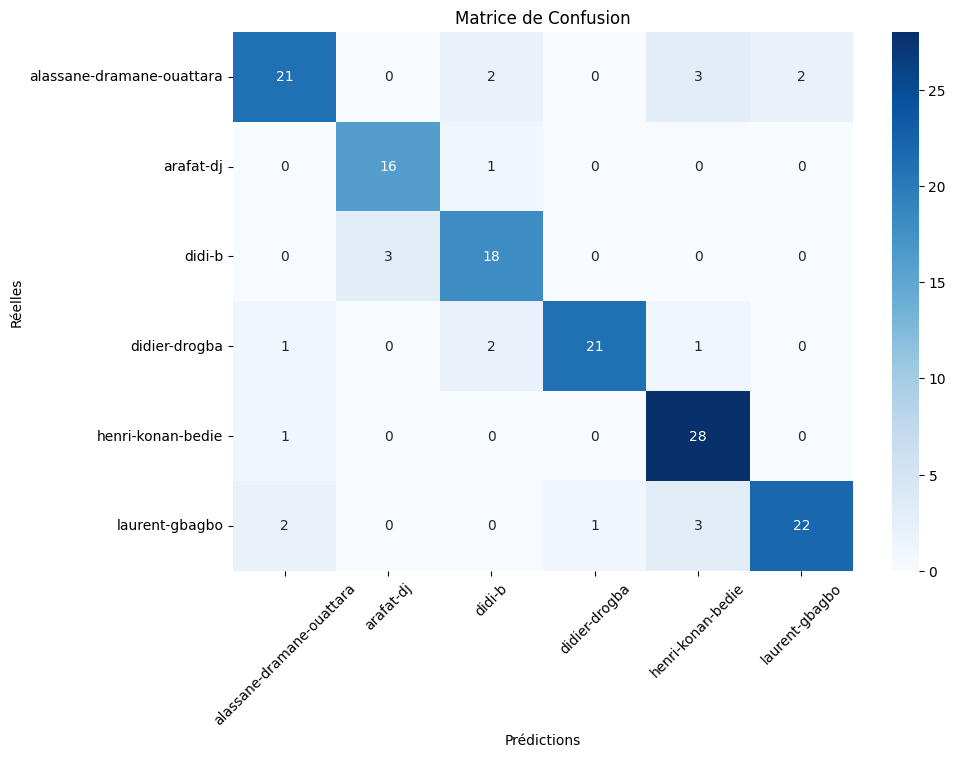

Accuracy: 85.14%
Accuracy_manuel: 85.14%
Latence moyenne par échantillon: 0.000926 secondes


In [47]:
# Chargement du modèle Enseignant et recuperation de l'accuracy et du temps de latence
net_cel = models.CelebrityNet()  
model_path_1 ='/home/holy/Documents/memoire/celebrity-recognition-ai/celebrity_recognition_ai/app/trained-models/celebritynet.pth'
net_cel.load_state_dict(torch.load(model_path_1))
net_cel =net_cel.to(device)
pre_cel,target_cel,train_accuracy_celebrityNet,_,train_latence_celebrity=evaluate_model(net_cel, val_loader, device)

/tmp/ipykernel_5460/680236178.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_stud.load_state_dict(torch.load(model_path_2))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.67      0.64      0.65        28
                arafat-dj       0.76      0.76      0.76        17
                   didi-b       0.75      0.43      0.55        21
            didier-drogba       0.71      0.40      0.51        25
        henri-konan-bedie       0.82      0.48      0.61        29
           laurent-gbagbo       0.36      0.79      0.49        28

                 accuracy                           0.58       148
                macro avg       0.68      0.58      0.60       148
             weighted avg       0.67      0.58      0.59       148



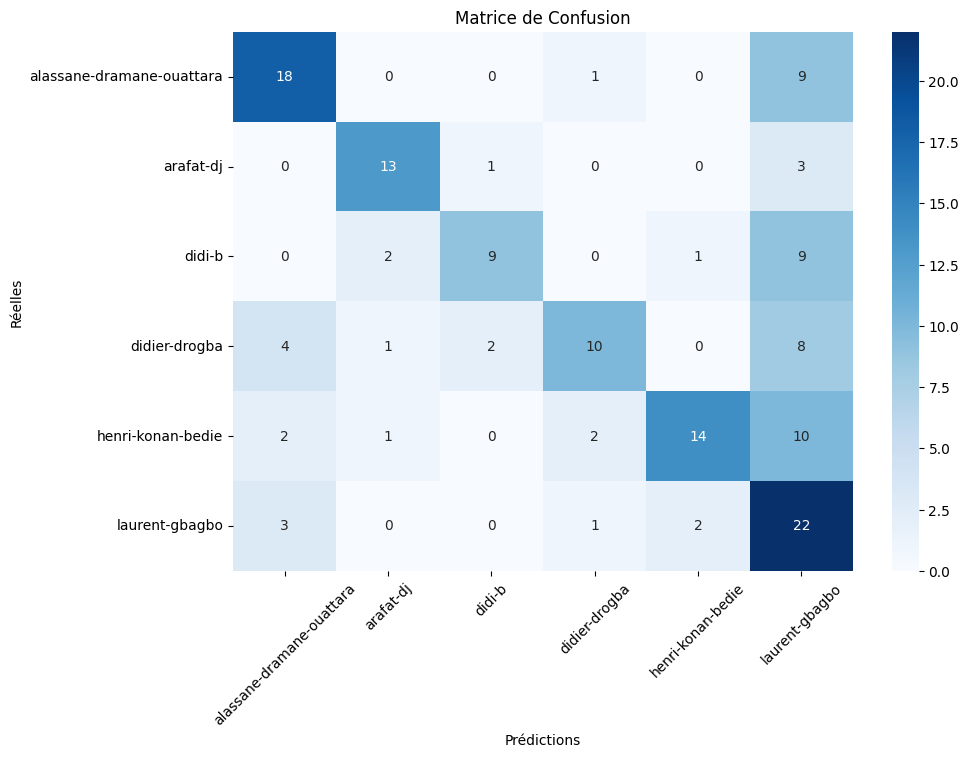

Accuracy: 58.11%
Accuracy_manuel: 58.11%
Latence moyenne par échantillon: 0.000228 secondes


In [48]:
# Chargement du modèle entrainé avec du module etudiant

net_stud = etudiant.StudentEfficientNetB4()
model_path_2 ='/home/holy/Documents/memoire/celebrity-recognition-ai/etudiant_0.pth'
net_stud.load_state_dict(torch.load(model_path_2))
net_stud=net_stud.to(device)
pred_stud,target_stud,train_accuracy_StudentEfficientNet,_,train_latence__StudentEfficientNet=evaluate_model(net_stud, val_loader, device)

/tmp/ipykernel_5460/146400775.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_mobil.load_state_dict(torch.load(model_path_3))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.96      0.89      0.93        28
                arafat-dj       0.71      1.00      0.83        17
                   didi-b       1.00      0.71      0.83        21
            didier-drogba       1.00      0.92      0.96        25
        henri-konan-bedie       1.00      0.97      0.98        29
           laurent-gbagbo       0.88      1.00      0.93        28

                 accuracy                           0.92       148
                macro avg       0.92      0.92      0.91       148
             weighted avg       0.94      0.92      0.92       148



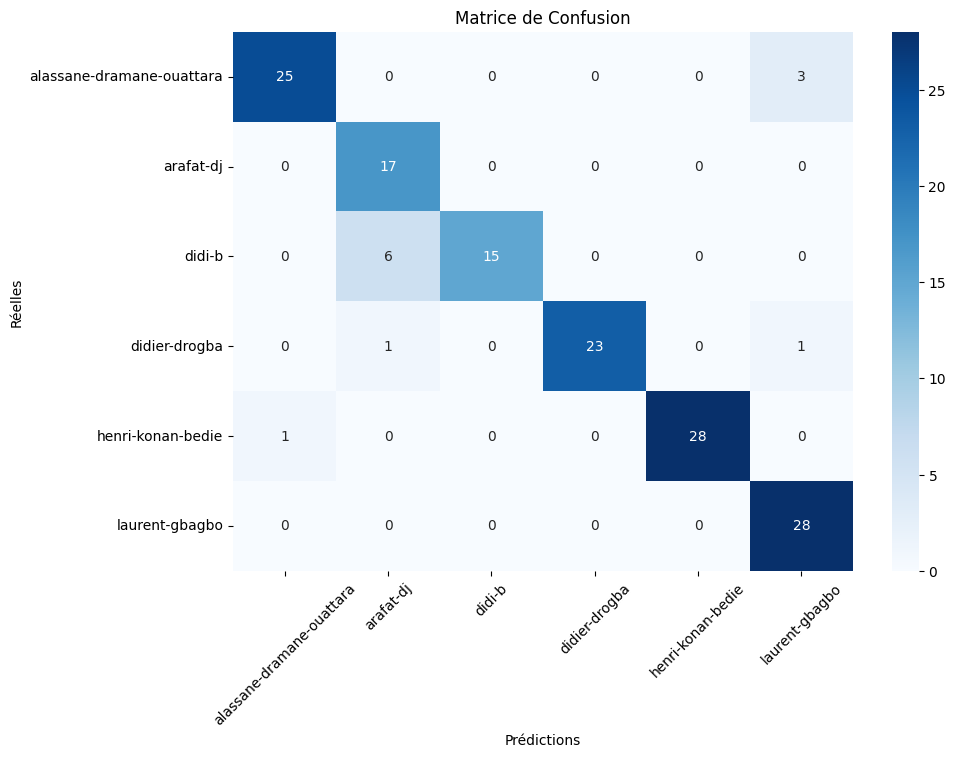

Accuracy: 91.89%
Accuracy_manuel: 91.89%
Latence moyenne par échantillon: 0.000513 secondes


In [49]:
# Chargement du modèle entrainé avec Mobilenet_100 du module mobilenet_v2_100
net_mobil = Mobilenet_100()
model_path_3 ='/home/holy/Documents/memoire/celebrity-recognition-ai/stu_mobileNet.pth'
net_mobil.load_state_dict(torch.load(model_path_3))
net_mobil=net_mobil.to(device)
pred_mobil,target_mobil,train_accuracy_Mobilenet_100,_,train_latence__Mobilenet_100 =evaluate_model(net_mobil, val_loader, device)

/tmp/ipykernel_5460/1259002724.py:6: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_bo.load_state_dict(torch.load(model_path_4))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       1.00      0.89      0.94        28
                arafat-dj       0.85      1.00      0.92        17
                   didi-b       0.95      0.86      0.90        21
            didier-drogba       1.00      1.00      1.00        25
        henri-konan-bedie       0.97      1.00      0.98        29
           laurent-gbagbo       0.93      0.96      0.95        28

                 accuracy                           0.95       148
                macro avg       0.95      0.95      0.95       148
             weighted avg       0.96      0.95      0.95       148



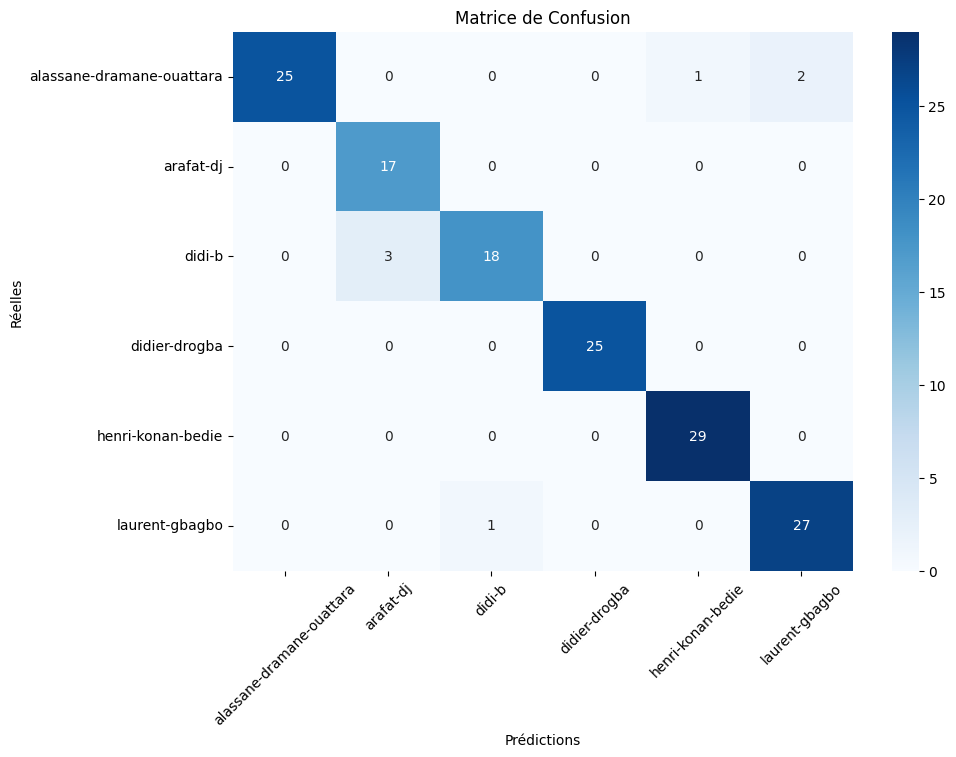

Accuracy: 95.27%
Accuracy_manuel: 95.27%
Latence moyenne par échantillon: 0.000601 secondes


In [52]:
# Chargement du modèle entrainé avec du module student_bo.py

net_bo = StudentNetbo()
model_path_4 ='etudi_bo_reg0123.pth'

net_bo.load_state_dict(torch.load(model_path_4))
net_bo=net_bo.to(device)
pred_bo,target_bo,train_accuracy_StudentNetbo,_,train_latence__StudentNetbo=evaluate_model(net_bo, val_loader, device)

/tmp/ipykernel_5460/2316885390.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_reg.load_state_dict(torch.load(model_path_5))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.96      0.93      0.95        28
                arafat-dj       0.89      0.94      0.91        17
                   didi-b       0.90      0.86      0.88        21
            didier-drogba       1.00      0.92      0.96        25
        henri-konan-bedie       1.00      1.00      1.00        29
           laurent-gbagbo       0.90      1.00      0.95        28

                 accuracy                           0.95       148
                macro avg       0.94      0.94      0.94       148
             weighted avg       0.95      0.95      0.95       148



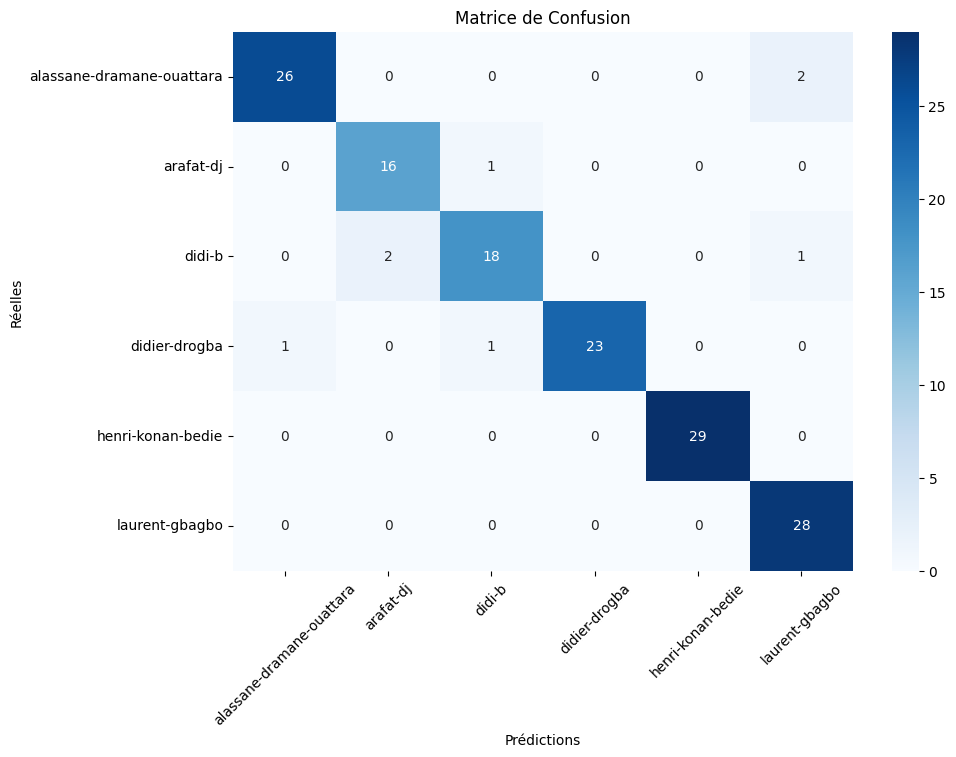

Accuracy: 94.59%
Accuracy_manuel: 94.59%
Latence moyenne par échantillon: 0.000644 secondes


In [53]:
# Modèle  with regressor
model_path_5 ='student_regressor0.pth'

net_reg = ModifiedStudentNetboRegressor()
net_reg.load_state_dict(torch.load(model_path_5))
net_reg.to(device)
pred_boReg,target_boReg,train_accuracy_ModifiedStudentNetboRegressor,_,train_latence__ModifiedStudentNetboRegressor=evaluate_model(net_reg, val_loader, device,True)

/tmp/ipykernel_5460/3206124338.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_cos.load_state_dict(torch.load(path_6))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       1.00      0.89      0.94        28
                arafat-dj       0.94      1.00      0.97        17
                   didi-b       1.00      0.95      0.98        21
            didier-drogba       1.00      1.00      1.00        25
        henri-konan-bedie       1.00      1.00      1.00        29
           laurent-gbagbo       0.90      1.00      0.95        28

                 accuracy                           0.97       148
                macro avg       0.97      0.97      0.97       148
             weighted avg       0.98      0.97      0.97       148



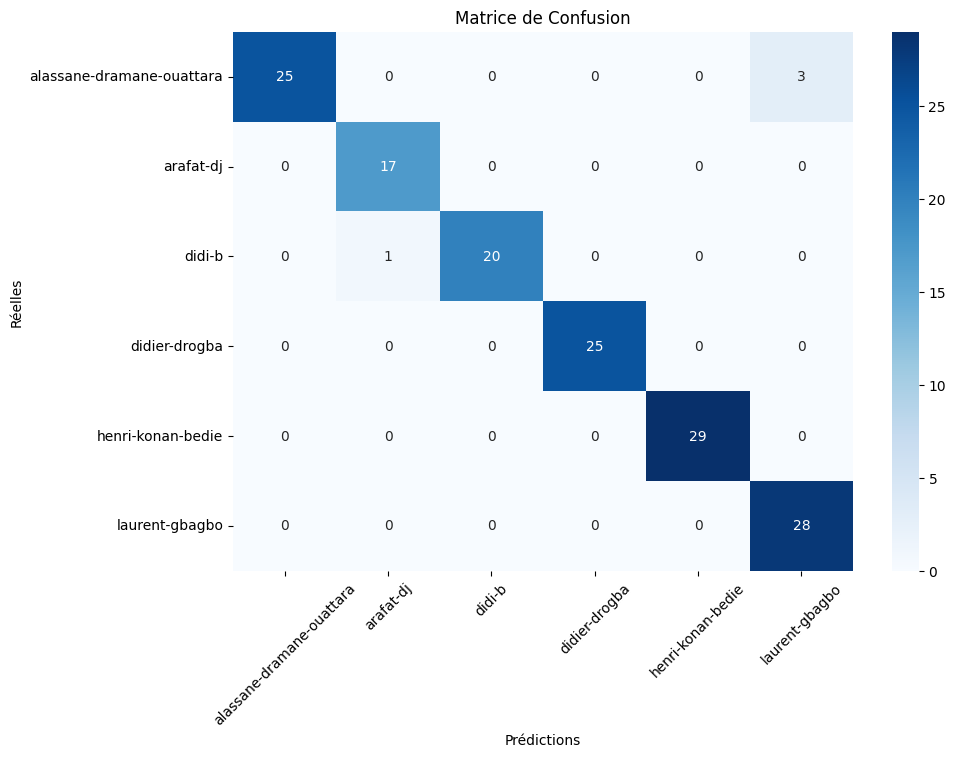

Accuracy: 97.30%
Accuracy_manuel: 97.30%
Latence moyenne par échantillon: 0.000305 secondes


In [55]:
# Modèle modified Cosinus loss
path_6 ="student_bo_cosLoss_0.pth"
net_cos = ModifiedStudentNetboCosinu()
net_cos.load_state_dict(torch.load(path_6))
net_cos.to(device)
pred_boCos,target_boCos,train_accuracy_ModifiedStudentNetboCosinu,_,train_latence__ModifiedStudentNetboCosinu=evaluate_model(net_cos, val_loader, device,True)

/tmp/ipykernel_5460/703464991.py:4: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  net_mobilReg.load_state_dict(torch.load(model_path_7))


Rapport de classification:
                           precision    recall  f1-score   support

alassane-dramane-ouattara       0.93      0.89      0.91        28
                arafat-dj       0.85      1.00      0.92        17
                   didi-b       1.00      0.86      0.92        21
            didier-drogba       1.00      0.96      0.98        25
        henri-konan-bedie       1.00      0.97      0.98        29
           laurent-gbagbo       0.90      1.00      0.95        28

                 accuracy                           0.95       148
                macro avg       0.95      0.95      0.94       148
             weighted avg       0.95      0.95      0.95       148



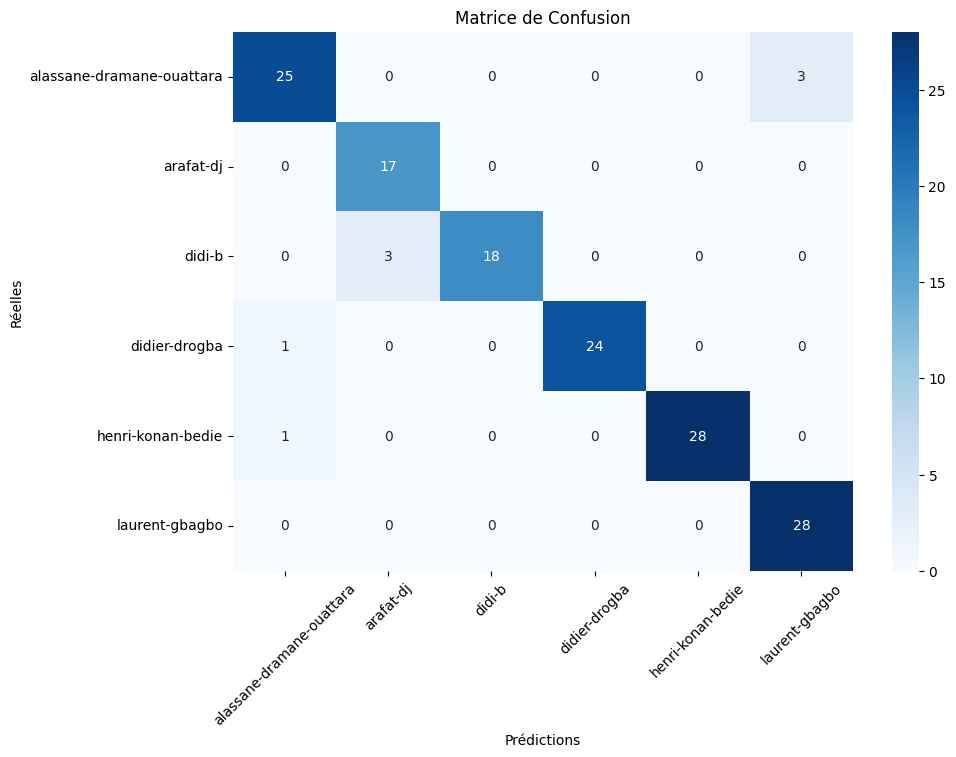

Accuracy: 94.59%
Accuracy_manuel: 94.59%
Latence moyenne par échantillon: 0.000474 secondes


In [56]:
# Chargement du modèle entrainé avec Mobilenet_100 du module mobilenet_v2_100
net_mobilReg=  modifiedMobilenet_100Reg()
model_path_7 ='mobil_reg001.pth'
net_mobilReg.load_state_dict(torch.load(model_path_7))
net_mobilReg=net_mobilReg.to(device)
pred_mobilReg,target_mobilReg,train_accuracy_modifiedMobilenet_100Reg,_,train_latence__modifiedMobilenet_100Reg =evaluate_model(net_mobilReg, val_loader, device,True)

In [57]:
from tabulate import tabulate

# Données pour le tableau
data = [
    ["CelebrityNet", train_accuracy_celebrityNet, train_latence_celebrity,os.path.getsize(model_path_1)/1024,params_celebrity
],
    ["StudentEfficientNet", train_accuracy_StudentEfficientNet, train_latence__StudentEfficientNet,os.path.getsize(model_path_2)/1024,params_studentNetb4],
    ["Mobilenet_100",train_accuracy_Mobilenet_100,train_latence__Mobilenet_100,os.path.getsize(model_path_3)/1024,params_mobileNet],
    ["StudentNetbo",train_accuracy_StudentNetbo,train_latence__StudentNetbo,os.path.getsize(model_path_4)/1024,params_studentbo],
    ["ModifiedStudentNetboRegressor", train_accuracy_ModifiedStudentNetboRegressor,train_latence__ModifiedStudentNetboRegressor,os.path.getsize(model_path_5)/1024,params_studentboReg],
    ["ModifiedStudentNetboCosinu", train_accuracy_ModifiedStudentNetboCosinu,train_latence__ModifiedStudentNetboCosinu,os.path.getsize(path_6)/1024,params_studentboCosinus],
    ["ModifiedMobileReg", train_accuracy_modifiedMobilenet_100Reg,train_latence__modifiedMobilenet_100Reg,os.path.getsize(model_path_7)/1024,params_mobileReg],






]

# En-têtes du tableau
headers = ["Models", "Test Accuracy", "Test Latency","Taille", "model parameter"]

# Affichage du tableau
print("                                       BENCHMARK TEST")

print(tabulate(data, headers=headers, tablefmt="pretty"))


                                       BENCHMARK TEST
+-------------------------------+--------------------+------------------------+-----------------+-----------------+
|            Models             |   Test Accuracy    |      Test Latency      |     Taille      | model parameter |
+-------------------------------+--------------------+------------------------+-----------------+-----------------+
|         CelebrityNet          | 0.8513513513513513 | 0.0009256424130620184  | 69326.13671875  |   17,559,374    |
|      StudentEfficientNet      | 0.581081081081081  | 0.00022780411952250712 | 26840.271484375 |    6,827,430    |
|         Mobilenet_100         | 0.918918918918919  | 0.0005127997011751742  |  8961.93359375  |    2,231,558    |
|         StudentNetbo          | 0.9527027027027027 | 0.0006006327835289208  | 15979.416015625 |    4,015,234    |
| ModifiedStudentNetboRegressor | 0.9459459459459459 | 0.0006442166663504935  | 39287.353515625 |    9,981,250    |
|  ModifiedStudent

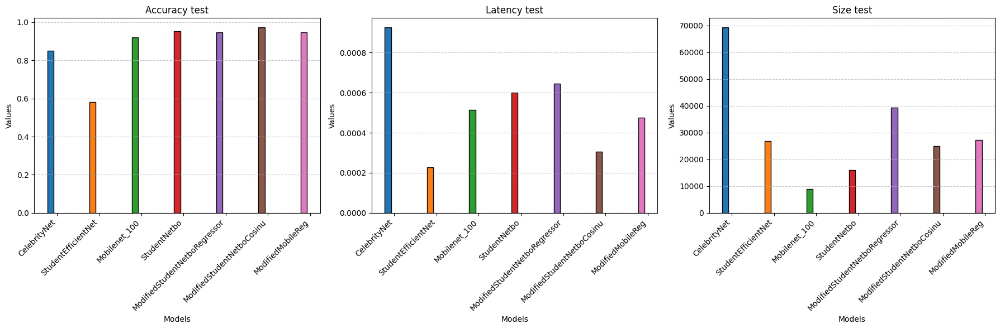

In [58]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import os

# Données pour chaque modèle
modeles = ["CelebrityNet", "StudentEfficientNet", "Mobilenet_100", "StudentNetbo", "ModifiedStudentNetboRegressor", "ModifiedStudentNetboCosinu","ModifiedMobileReg"]
accuracies = [
    train_accuracy_celebrityNet,
    train_accuracy_StudentEfficientNet,
    train_accuracy_Mobilenet_100,
    train_accuracy_StudentNetbo,
    train_accuracy_ModifiedStudentNetboRegressor,
    train_accuracy_ModifiedStudentNetboCosinu,
    train_accuracy_modifiedMobilenet_100Reg
    
]
latencies = [
    train_latence_celebrity,
    train_latence__StudentEfficientNet,
    train_latence__Mobilenet_100,
    train_latence__StudentNetbo,
    train_latence__ModifiedStudentNetboRegressor,
    train_latence__ModifiedStudentNetboCosinu,
    train_latence__modifiedMobilenet_100Reg
]
sizes = [
    os.path.getsize(model_path_1) / 1024,
    os.path.getsize(model_path_2) / 1024,
    os.path.getsize(model_path_3) / 1024,
    os.path.getsize(model_path_4) / 1024,
    os.path.getsize(model_path_5) / 1024,
    os.path.getsize(path_6) / 1024,
    os.path.getsize(model_path_7) / 1024
]

# Créer la figure et les sous-graphes
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6), sharey=False)

# Palette de couleurs pour les modèles
colors = sns.color_palette("tab10", len(modeles))

# Largeur des barres
bar_width = 0.15
index = np.arange(len(modeles))

# Position des barres pour chaque métrique
bar_positions = np.arange(len(modeles))

# Créer des barres pour Accuracy
for i, (model, accuracy) in enumerate(zip(modeles, accuracies)):
    ax1.bar(bar_positions[i] - bar_width, accuracy, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax1.set_title('Accuracy test')
ax1.set_xlabel('Models')
ax1.set_ylabel('Values')
ax1.set_xticks(bar_positions)
ax1.set_xticklabels(modeles, rotation=45, ha='right')
ax1.grid(axis='y', linestyle='--', alpha=0.7)

# Créer des barres pour Latency
for i, (model, latency) in enumerate(zip(modeles, latencies)):
    ax2.bar(bar_positions[i] - bar_width, latency, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax2.set_title('Latency test')
ax2.set_xlabel('Models')
ax2.set_ylabel('Values')
ax2.set_xticks(bar_positions)
ax2.set_xticklabels(modeles, rotation=45, ha='right')
ax2.grid(axis='y', linestyle='--', alpha=0.7)

# Créer des barres pour Size
for i, (model, size) in enumerate(zip(modeles, sizes)):
    ax3.bar(bar_positions[i] - bar_width, size, bar_width, color=colors[i], edgecolor='black', label=model if i == 0 else "")
ax3.set_title('Size test')
ax3.set_xlabel('Models')
ax3.set_ylabel('Values')
ax3.set_xticks(bar_positions)
ax3.set_xticklabels(modeles, rotation=45, ha='right')
ax3.grid(axis='y', linestyle='--', alpha=0.7)


# Ajuster la disposition
plt.tight_layout()

# Afficher la figure
plt.show()


#### Aperçu des predictions comparées à la realité avec le modèle modifiedCosinus

In [59]:
import torch
from sklearn.metrics import classification_report
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Exemple de mappage des indices de classe vers les noms
class_names = categories

def evaluate_model1(model, data_loader, device):
    model.eval()  # Mettre le modèle en mode évaluation
    all_preds = []
    all_targets = []

    with torch.no_grad():
        for data, target in data_loader:
            data, target = data.to(device), target.to(device)
            outputs,_ = model(data)
            _, preds = torch.max(outputs, 1)  # Obtenir les prédictions des classes
            
            # Convertir les cibles one-hot en indices de classes si nécessaire
            if target.dim() > 1:  # Si les cibles sont en one-hot
                target = torch.argmax(target, dim=1)

            # Convertir les cibles et les prédictions en numpy
            all_preds.append(preds.cpu().numpy())
            all_targets.append(target.cpu().numpy())

            # Convertir les tensors en numpy arrays
            data = data.cpu().numpy().transpose(0, 2, 3, 1)
          # Normaliser les données dans la plage [0, 1] si elles sont des flottants
            if data.dtype == np.float32 or data.dtype == np.float64:
                data = data / 255.0
            # Afficher les images avec leurs prédictions
            for i in range(len(data)):
         
                img = data[i]
                img = np.clip(img, 0, 1)  # Clipper les valeurs pour l'affichage
                pred_label = preds[i].item()
                target_label = target[i].item()
                
                # Afficher l'image et les résultats
                plt.imshow(img)
                plt.title(f'Prédiction: {class_names[pred_label]}, Réel: {class_names[target_label]}')
                plt.axis('off')
                plt.show()

    # Convertir les listes en tableaux numpy
    all_preds = np.concatenate(all_preds)
    all_targets = np.concatenate(all_targets)
    
    # Calculer le rapport de classification
    report = classification_report(all_targets, all_preds)
    print(f'Rapport de classification:\n{report}')

# Exemple d'appel de la fonction
# evaluate_model(your_model, your_data_loader, your_device)


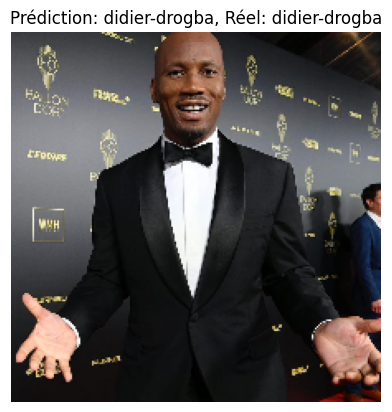

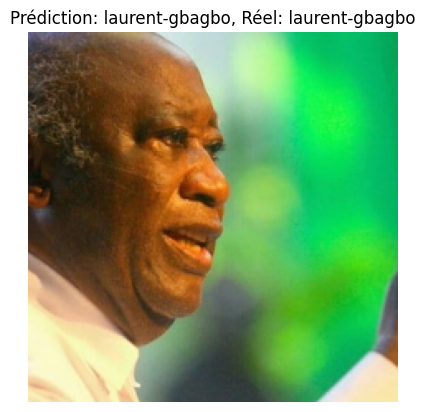

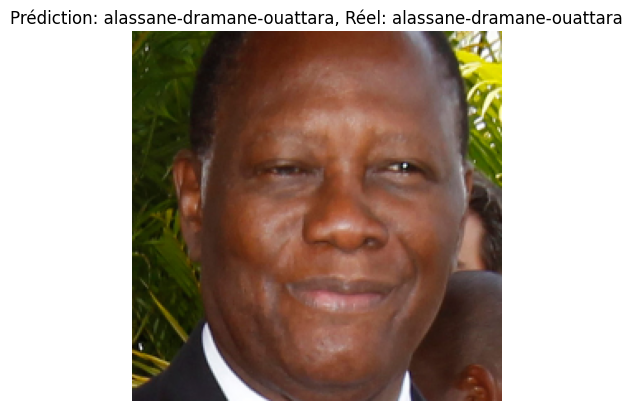

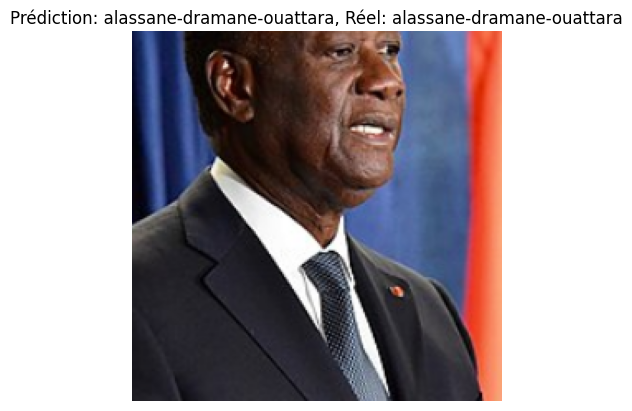

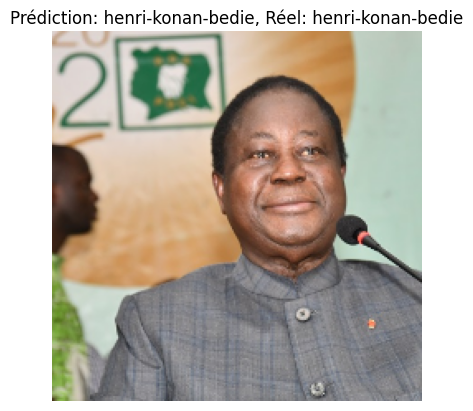

...

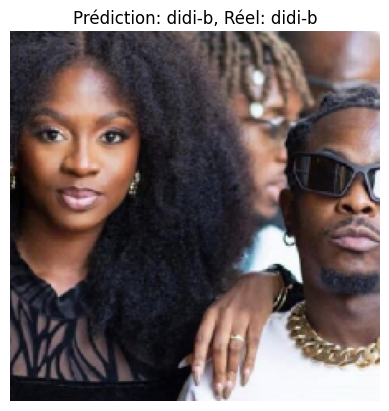

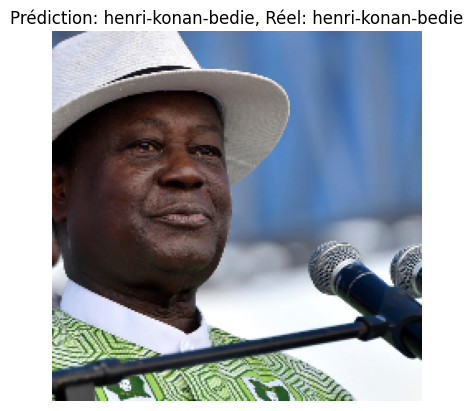

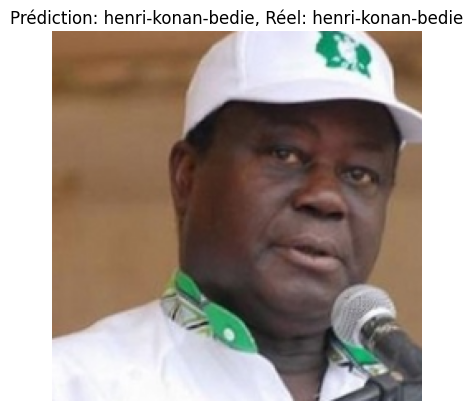

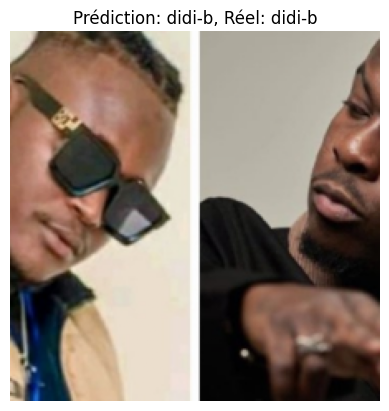

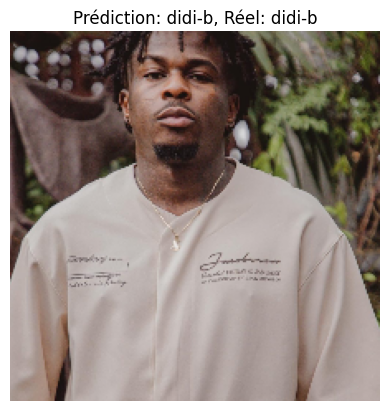

Rapport de classification:
              precision    recall  f1-score   support

           0       1.00      0.89      0.94        28
           1       0.94      1.00      0.97        17
           2       1.00      0.95      0.98        21
           3       1.00      1.00      1.00        25
           4       1.00      1.00      1.00        29
           5       0.90      1.00      0.95        28

    accuracy                           0.97       148
   macro avg       0.97      0.97      0.97       148
weighted avg       0.98      0.97      0.97       148



In [60]:
evaluate_model1(net_cos,val_loader, device=device)